Fast Hough Transform

In [4]:
import numpy as np
import cv2
import math
import matplotlib.pyplot as plt

In [2]:
images = []

for i in range(1, 11):
    images.append(np.asarray(cv2.imread(f'images/{i}.jpg', cv2.IMREAD_COLOR)))

In [3]:
fht_cache = dict()

In [5]:
def fht(img, xmin, xmax):
    result = np.zeros([img.shape[0], xmax - xmin])
    if xmax - xmin == 1:
        result[:, 0] = img[:, xmin]
    else:
        mid = (xmin + xmax) // 2
        ans1 = fht(img, xmin, mid)
        ans2 = fht(img, mid, xmax)
        for x in range(img.shape[0]):
            for shift in range(xmax-xmin):
                result[x, shift] = ans1[x, shift // 2] + \
                                   ans2[(x + shift // 2 + shift % 2) % img.shape[0], shift // 2]
    return result

def fht_with_pad(img, idx=None):
    if (idx and idx in fht_cache):
        return fht_cache[idx]
    x_shape = 2 ** math.ceil(math.log2(img.shape[1]))
    pad_size = (x_shape - img.shape[1]) // 2
    padded_img = np.pad(img, 
        [ [0, 0], [pad_size, pad_size + img.shape[1] % 2] ], 
        mode='constant',
        constant_values=[[0, 0], [0, 0]]
    )
    result = fht(padded_img, 0, x_shape)
    if (idx):
        fht_cache[idx] = result
    return result

def sobel(img):
    kernel = np.array([[1, 2, 1], 
                       [0, 0, 0], 
                       [-1, -2, -1]])
    return (cv2.filter2D(src=img, ddepth=-1, kernel=kernel) ** 2 + cv2.filter2D(src=img, ddepth=-1, kernel=-kernel.T) ** 2) ** 0.5

Проверим работоспособность алгоритма: сделаем препроцессинг с помощью медианного фильтра и фильтра Собеля, посчитаем дисперсии по столбцам у оригинального и отраженного по вертикали изображения, найдем максимум, получим угол. Повернем картинку на нужный угол.

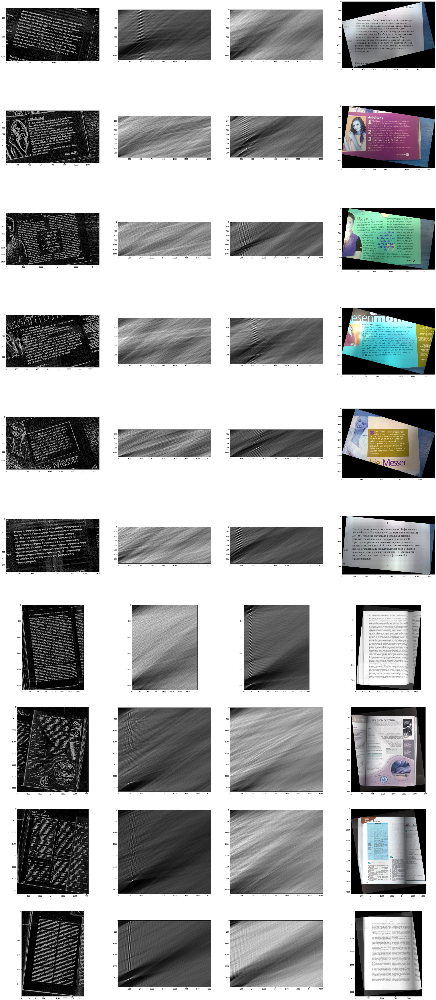

In [6]:
from scipy import ndimage

angles = []

plt.figure(figsize=(50, 120))
for i in range(len(images)):
    grayscale = cv2.cvtColor(images[i], cv2.COLOR_BGR2GRAY)
    input_img = sobel(cv2.medianBlur(grayscale, 15))
    subplot = plt.subplot(10, 4, i * 4 + 1)
    subplot.imshow(input_img, cmap="gray")

    orig = fht_with_pad(input_img, i)
    subplot = plt.subplot(10, 4, i * 4 + 2)
    subplot.imshow(orig, cmap="gray")
    flipped = fht_with_pad(np.flip(input_img, axis=1), i + len(images))
    subplot = plt.subplot(10, 4, i * 4 + 3)
    subplot.imshow(flipped, cmap="gray")
    var_orig = np.var(orig, axis=0)
    var_flipped = np.var(flipped, axis=0)
    (max_var, max_var_result) = (var_orig, orig) if var_orig.max() > var_flipped.max() else (var_flipped, flipped)
    
    angle = math.atan(np.argmax(max_var) / max_var_result.shape[1]) * (-1 if max_var.max() == var_flipped.max() else 1)
    angles.append(angle)
    subplot = plt.subplot(10, 4, i * 4 + 4)
    subplot.imshow(ndimage.rotate(images[i], angle * 180 / np.pi))
plt.show()

In [7]:
def rotate_nn(img, angle):
    kernel = np.array([[np.cos(angle),  np.sin(angle)],
                       [-np.sin(angle), np.cos(angle)]])

    rev_kernel = np.array([[np.cos(angle), -np.sin(angle)],
                           [np.sin(angle), np.cos(angle)]])

    new_shape = np.round(np.abs(kernel) @ np.array(img.shape[:2])).astype(int)
    center = (np.array([img.shape[0], img.shape[1]]) / 2).astype(int)
    new_center = new_shape / 2
    result = np.zeros(shape=(new_shape[0], new_shape[1], img.shape[2]), dtype=np.uint8)

    for i in range(result.shape[0]):
        for j in range(result.shape[1]):
            i_img, j_img = np.round(kernel @ (np.array([i, j]) - new_center) + center).astype(int)
            if (i_img >= 0 and i_img < img.shape[0] and j_img >= 0 and j_img < img.shape[1]):
                result[i, j, :] = img[i_img, j_img, :]
    return result

def rotate_bilinear(img, angle):
    kernel = np.array([[np.cos(angle),  np.sin(angle)],
                       [-np.sin(angle), np.cos(angle)]])

    rev_kernel = np.array([[np.cos(angle), -np.sin(angle)],
                           [np.sin(angle), np.cos(angle)]])

    new_shape = np.round(np.abs(kernel) @ np.array(img.shape[:2])).astype(int)
    center = (np.array([img.shape[0], img.shape[1]]) / 2).astype(int)
    new_center = new_shape / 2
    result = np.zeros(shape=(new_shape[0], new_shape[1], img.shape[2]), dtype=np.uint8)

    for i in range(result.shape[0]):
        for j in range(result.shape[1]):
            x, y = kernel @ (np.array([i, j]) - new_center) + center

            def crop(x, v):
                return max(0, min(x, v))
            pixels = img[crop(np.floor(x).astype(int), img.shape[0]):crop(np.ceil(x).astype(int) + 1, img.shape[0]), 
                         crop(np.floor(y).astype(int), img.shape[1]):crop(np.ceil(y).astype(int) + 1, img.shape[1]), :]
            if (pixels.size > 0):
                result[i, j, :] = np.mean(np.vstack(pixels), axis=0)
    return result

    

In [10]:
rotated = []
for i in range(len(images)):
    rotated.append([rotate_nn(images[i], angles[i]), rotate_bilinear(images[i], angles[i])])

Посмотрим на визуальные отличия двух алгоритмов поворота:

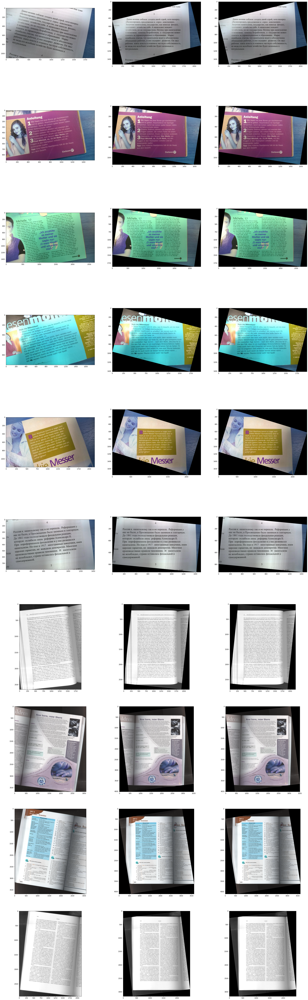

In [13]:
plt.figure(figsize=(35, 120))
for i in range(len(images)):
    plt.subplot(10, 3, 3 * i + 1)
    plt.imshow(images[i])
    plt.subplot(10, 3, 3 * i + 2)
    plt.imshow(rotated[i][0])
    plt.subplot(10, 3, 3 * i + 3)
    plt.imshow(rotated[i][1])

plt.show()

In [13]:
import time

times = []
max_pow = 13
for size in range(max_pow):
    img = np.random.randint(256, size=[2 ** size, 2 ** size]).astype(np.int8)
    start = time.time()
    fht(img, 0, 2 ** size)
    end = time.time()
    times.append(end - start)

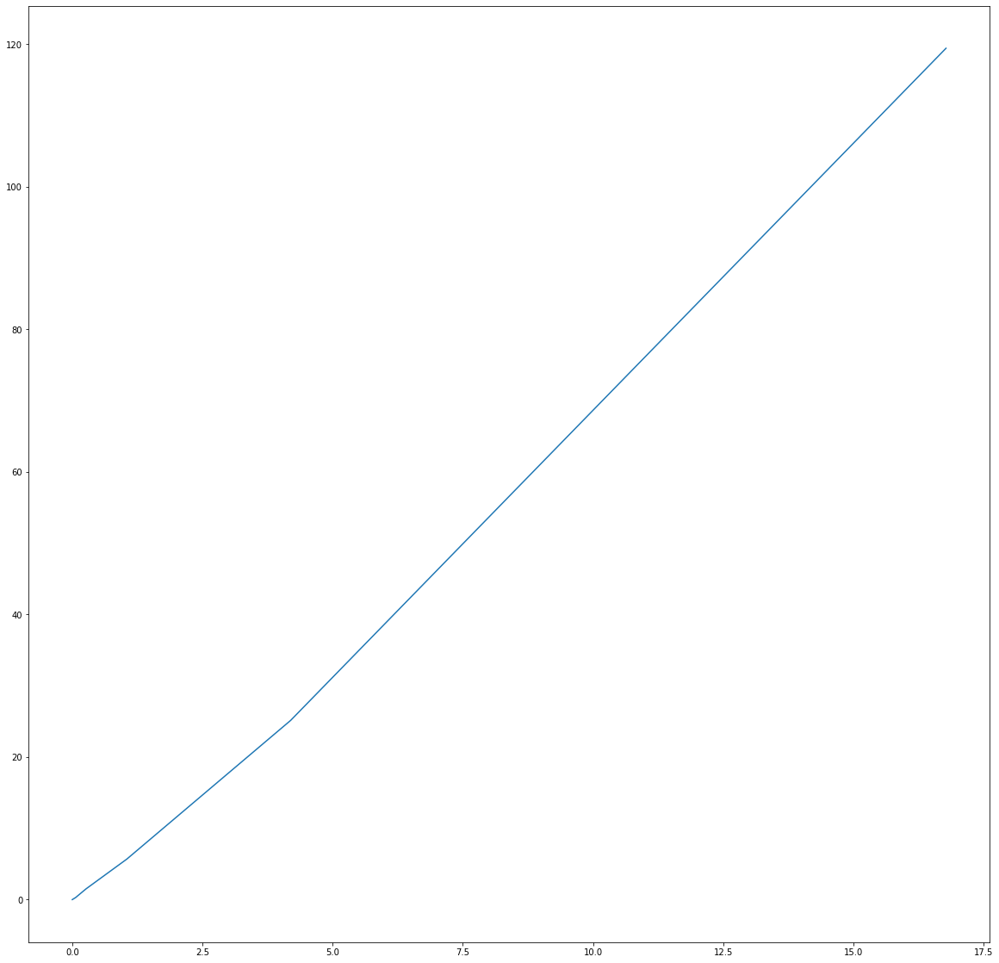

In [ ]:
plt.figure(figsize=(20, 20))
plt.plot(np.exp2(np.arange(len(times))) ** 2 / 10 ** 6, times)
plt.title("Seconds(megapixels)")
plt.show()

Сложность FHT для картинки со стороной $m$ --- $O(m^2\log m)$. График выглядит почти линейно, количество мегапикселей прямо пропорционально $m^2$, значит получилось что-то похожее на правду. 

Сложность по памяти - $O(m^2)$, для хранения результата. Можно попробовать сделать алгоритм inplace и избавиться от этого, но я наткнулся на несколько подводных камней и не придумал, как от них избавиться.

Дизайн алгоритма позволяет достаточно эффективно его параллелить и векторизовать, значительно ускоряя.